<a href="https://colab.research.google.com/github/gauriagarwal18/Telecom-Churn-Analysis/blob/master/Telecom_Churn_Analysis_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Telecom Churn Analysis**

Orange S.A., formerly France Télécom S.A., is a French multinational telecommunications corporation. The Orange Telecom's Churn Dataset, consists of cleaned customer activity data (features), along with a churn label specifying whether a customer canceled the subscription.

In this project I have Explored and analyzed the data to discover key factors responsible for customer churn and come up with ways/recommendations to ensure customer retention.
 
Also I have built a model to check whether a customer with given qualities will churn or not.

##Data Descripton And Cleaning

###We are using the following libraries for analysis:
- Numpy: We will use numpy arrays as they are comparitively faster than lists, also columns of dataframes behaves as numpy arrays

- Pandas: for reading the data from csv file, for data clening and for preparing data for analysis

- matplotlib,seaborn: for different visualisations, for drawing conclusions from data and for exploratory data analysis. 

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

###Loading CSV file from google drive in colab enviroment
We will first load our csv file in which data is stored to the colab enviroment in data frame format so that we can make the copy of the original data and perform the required cleaning and analysis on that data without changing the original one.



In [4]:
#Download datasets Hepatitis automobile from UCI repository
from google.colab import drive
drive.mount('/content/drive')
import os
path="/content/drive/My Drive/AlmaBetter_Capstone_projects/telecom_churn_analysis/TelecomChurn.csv"

telecom_original=pd.read_csv(path)
telecom= telecom_original.copy()

Mounted at /content/drive


###Description:

The data set is a combination of different types of variables among which some are categorical variables some are discrete variables and some are continuous variables.

To make required analysis from the given raw data we have to perform following steps:

**step1 [Understanding the data deeply]**: Read the data thoroughly and understand the connections between different attributes

**step2 [Data Cleaning]**: This data is raw data and it may contains lot of noise so we  have to remove it for proper analysis with minimum or no error.

**step3 [Analysing and Concluding]**: After data cleaing, data is ready for further analysis, so we make required analysis and visulisation for various attributes of data and for required combinations of attributes of data.

**step4 [Model Builing]**: After required analysis I will make a model to find out whether a customer will be churn or not.


In [5]:
telecom.head(5)

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
0,KS,128,415,No,Yes,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,OH,107,415,No,Yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,NJ,137,415,No,No,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,OH,84,408,Yes,No,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False
4,OK,75,415,Yes,No,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False


In [6]:
telecom.describe(include="all")

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
count,3333,3333.000000,3333.000000,3333,3333,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333
unique,51,NaN,NaN,2,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2
top,WV,NaN,NaN,No,No,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
freq,106,NaN,NaN,3010,2411,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2850
mean,NaN,101.064806,437.182418,NaN,NaN,8.099010,179.775098,100.435644,30.562307,200.980348,100.114311,17.083540,200.872037,100.107711,9.039325,10.237294,4.479448,2.764581,1.562856,NaN
std,NaN,39.822106,42.371290,NaN,NaN,13.688365,54.467389,20.069084,9.259435,50.713844,19.922625,4.310668,50.573847,19.568609,2.275873,2.791840,2.461214,0.753773,1.315491,NaN
min,NaN,1.000000,408.000000,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,23.200000,33.000000,1.040000,0.000000,0.000000,0.000000,0.000000,NaN
25%,NaN,74.000000,408.000000,NaN,NaN,0.000000,143.700000,87.000000,24.430000,166.600000,87.000000,14.160000,167.000000,87.000000,7.520000,8.500000,3.000000,2.300000,1.000000,NaN
50%,NaN,101.000000,415.000000,NaN,NaN,0.000000,179.400000,101.000000,30.500000,201.400000,100.000000,17.120000,201.200000,100.000000,9.050000,10.300000,4.000000,2.780000,1.000000,NaN
75%,NaN,127.000000,510.000000,NaN,NaN,20.000000,216.400000,114.000000,36.790000,235.300000,114.000000,20.000000,235.300000,113.000000,10.590000,12.100000,6.000000,3.270000,2.000000,NaN


In [7]:
telecom.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3333 entries, 0 to 3332
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   State                   3333 non-null   object 
 1   Account length          3333 non-null   int64  
 2   Area code               3333 non-null   int64  
 3   International plan      3333 non-null   object 
 4   Voice mail plan         3333 non-null   object 
 5   Number vmail messages   3333 non-null   int64  
 6   Total day minutes       3333 non-null   float64
 7   Total day calls         3333 non-null   int64  
 8   Total day charge        3333 non-null   float64
 9   Total eve minutes       3333 non-null   float64
 10  Total eve calls         3333 non-null   int64  
 11  Total eve charge        3333 non-null   float64
 12  Total night minutes     3333 non-null   float64
 13  Total night calls       3333 non-null   int64  
 14  Total night charge      3333 non-null   

**Conclusions:** 
- Data have initially 20 columns, among which the churn columns that is our dependent column is of boolean data type, 8 columns each for float and int type,  and 3 column are of string or object type.
- The comapny have some plans like international plan and voice mail plans.
- We have given information like account length and the state of the user for which we can do analysis.
- also we note that there is no null value 

###Data cleaning:
**step1:**Removed null values: althoough there are no null values at present but it is possible that when the data get's updated it may consists some null values.

**step2:**Removed outliers so that some rare records do not affect our result.

**step3:**Then I have removed multicollinearity from the data.

**step4:**Then I performed feature engineering and added some required columns.

In [8]:
def print_null_percent(df):
  null_percent=pd.Series()
  for col in df.columns:
    null_percent[col]=((df.shape[0]-df[col].count())/(df.shape[0]))*100
  print("columns with null values\n",null_percent[null_percent!=0])



In [9]:
def remove_outliers(df):

  continuous_col=df.describe().columns
  df.boxplot(rot=90)
  plt.title("before removing outliers",)
  plt.show()
  
  for c in continuous_col:
    df.index=np.arange(0,df.shape[0])
    Q1=np.quantile(df[c],0.25)
    Q3=np.quantile(df[c],0.75)
    IQR= Q3 - Q1
    upper=np.where(df[c]>=(Q3+1.5*IQR))[0]
    #print(upper[0])
    lower=np.where(df[c]<=(Q1-1.5*IQR))[0]   #it will be a tuple and we require a numpy array which is at it's first index.
    #print(lower)
    outliers_idx=np.unique(np.append(upper,lower)) 
    df.drop(outliers_idx, inplace = True) 
    
    #df.loc[upper][c]=Q3
    #df.loc[lower][c]=Q1
     
  df.boxplot(rot=90)
  plt.title("after removing outliers",)
  plt.show()
  return df

In [10]:
def normalization(df,col_list):

  for c1 in col_list:
    try:
      mx=df.max()[c1]
      mn=df.min()[c1]
      df[c1]=(df[c1]-mn)/(mx-mn)
      col_list.remove(c1)    #so that c1 do  not get normalized again and again
    except:
      print(f"{c1} is not a numerical column, so it can not be normalized")
      col_list.remove(c1)
      normalization(df,col_list)

**In null values removal:**

- First I have set threshold to remove the columns with a particular percentage of null value in row or column.
- Then for left null values, replaced the null values in continuous columns with mean, and the null values in discrete columns with most frequently occuring values.

In [11]:

def cleaning(df,continuous_col=[],discrete_col=[],print_null=True,th=20.0):
  """
  this function removes all the null values from the data 
  """
  if len(continuous_col)==0:
    continuous_col=df.describe().columns

  print(f"before cleaning\n")
  print(f"shape of data: {df.shape}")
  if(print_null):
    print_null_percent(df)
  
  #step1
  #preserving columns having at least 20% of not null values
  df.dropna(axis=1,inplace=True,thresh=((th/100.0)*df.shape[0]))
  #preserving rows having at least 20% of not null values
  df.dropna(axis=0,inplace=True,thresh=((th/100.0)*df.shape[1]))

  #step2
  df.drop_duplicates(inplace=True,ignore_index=True)
  

  #step3
  #removing all the null values
  for c1 in df.columns:

    #i.e it is an non catagorical column
    if c1 in continuous_col: 
      df[c1].fillna(df[c1].mean(),inplace=True)
    else:
      df[c1].fillna(df[c1].value_counts().idxmax(),inplace=True)

  print(f"\n\nAfter cleaning the data\n")
  print(f"shape of data: {df.shape}")
  print_null_percent(df)
  return df

In [12]:
#from this we can get to know that class don't have any null value so there is no need to drop 
telecom=cleaning(telecom,th=20)
#print_null_percent(automobiles)

before cleaning

shape of data: (3333, 20)
columns with null values
 Series([], dtype: float64)


After cleaning the data

shape of data: (3333, 20)
columns with null values
 Series([], dtype: float64)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  


###Outliers removal:
I have printed boxplot before removing the outliers, and then after removing the outliers to identify the changes.

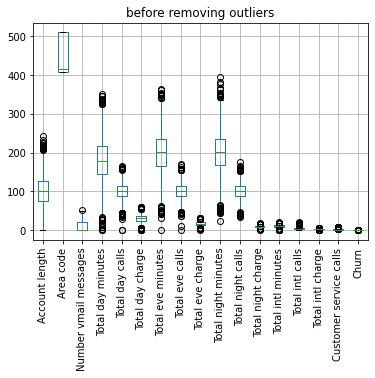

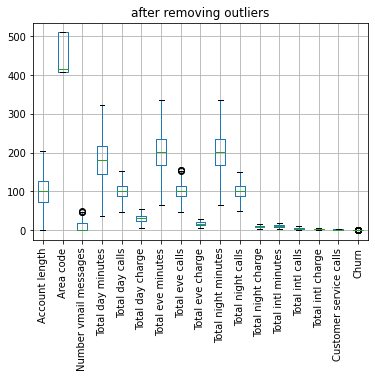

In [13]:
telecom=remove_outliers(telecom)

####**Feature Engineering:**

###Removing multicollinearity And Feature Engineering:
from the heat map we note that some features are highly correlated so we can replace them with one feature.

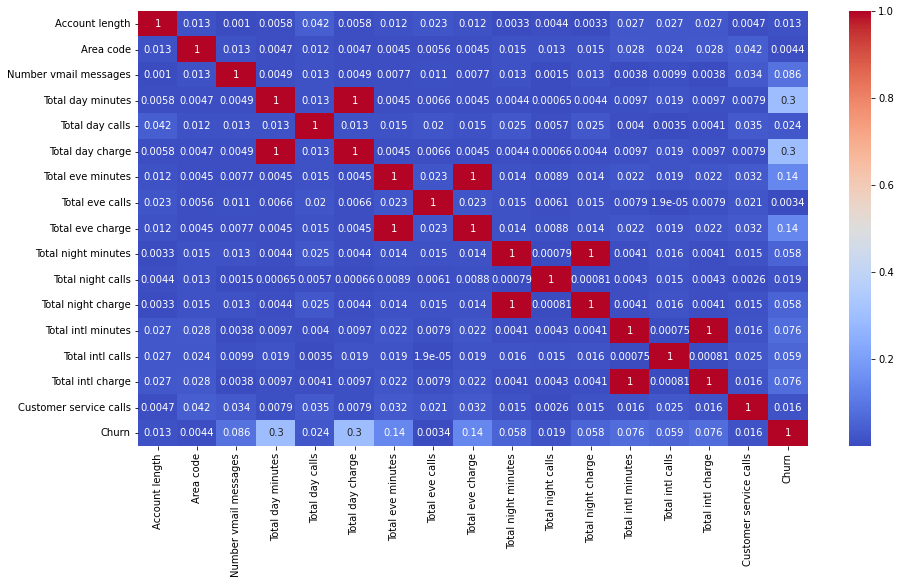

In [14]:
plt.figure(figsize=(15,8))
correlation = telecom.corr()
sns.heatmap(abs(correlation), annot=True, cmap='coolwarm')

In [15]:
#for day, eve, night calls checking cost per minute:
intl=(telecom["Total intl charge"]/telecom['Total intl minutes']).agg(['mean'])
day=(telecom["Total day charge"]/telecom['Total day minutes']).agg(['mean'])
eve=(telecom["Total eve charge"]/telecom['Total eve minutes']).agg(['mean'])
night=(telecom["Total night charge"]/telecom['Total night minutes']).agg(['mean'])
print(f"for international calls:\n{intl}\n\n")
print(f"for day calls:\n{day}\n\n")
print(f"for evening calls:\n{eve}\n\n")
print(f"for night calls:\n{night}\n\n")

#we found that the cost per minute for each type of call is different so we have to treat them separately

for international calls:
mean    0.270058
dtype: float64


for day calls:
mean    0.170003
dtype: float64


for evening calls:
mean    0.085001
dtype: float64


for night calls:
mean    0.045
dtype: float64




In [16]:
#from above heat map we noticed a collinearity of one with minutes we talked and the charges so we remove these columns by cost/minute
telecom["intl cost per min"]=telecom["Total intl charge"]/telecom['Total intl minutes']
telecom["day cost per min"]=telecom["Total day charge"]/telecom['Total day minutes']
telecom["eve cost per min"]=telecom["Total eve charge"]/telecom['Total eve minutes']
telecom["night cost per min"]=telecom["Total night charge"]/telecom['Total night minutes']

#droping extra columns
telecom.drop(["Total intl charge","Total day charge","Total eve charge","Total night charge",
                   'Total intl minutes','Total day minutes','Total eve minutes','Total night minutes'],axis=1,inplace=True)

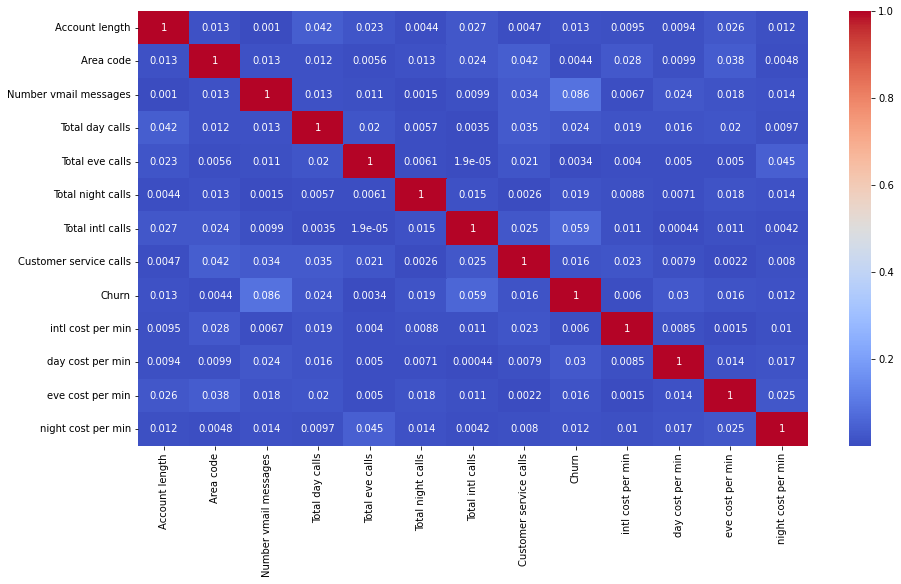

In [17]:
plt.figure(figsize=(15,8))
correlation = telecom.corr()
sns.heatmap(abs(correlation), annot=True, cmap='coolwarm')
#multicollinearity is now removed

**Conclusion:** from the heat map we note that-
- multicollinearity has now been removed from the data.
- Also we note that no feature shows a good correlation with churn attribute, so chances of a customer to be churn is not very certain but there must be some common trends which we can identify, and for which we have to do the required analysis and visualizaiton

##Data analysis

Now it's time to do some analysis on our data and make out some trends and find some reasons that leads an account to churn.

###Categorical Features Distribution

Now we first have a look at distribution of categorial attributes, what different values each of them have and in what number the values are distributed

In [18]:
categorical_features = telecom.describe(include=['object','boolean']).columns
categorical_features

Index(['State', 'International plan', 'Voice mail plan', 'Churn'], dtype='object')

In [19]:
for i in telecom.columns:
  if i in categorical_features:
    print("\n",i,"\n",telecom[i].value_counts())


 State 
 WV    90
MN    76
WI    68
AL    67
OH    65
NY    65
CT    64
VA    63
OR    63
UT    62
NJ    61
NC    60
KS    60
TX    60
WA    59
MT    59
MS    59
VT    58
ID    58
MI    58
MA    58
MD    57
NV    57
WY    57
IN    57
RI    56
ND    55
AZ    53
SD    53
FL    53
KY    52
MO    52
NE    52
DE    51
CO    51
IL    51
ME    51
NM    50
OK    49
TN    48
DC    48
AK    46
SC    45
GA    44
HI    44
NH    44
AR    43
LA    42
PA    38
IA    36
CA    25
Name: State, dtype: int64

 International plan 
 No     2527
Yes     266
Name: International plan, dtype: int64

 Voice mail plan 
 No     2018
Yes     775
Name: Voice mail plan, dtype: int64

 Churn 
 False    2489
True      304
Name: Churn, dtype: int64


here we note that data is highly biased, and there are very less number of customers who are churn.

###Visualization
Now let's begin with visualization

In [20]:
def make_pieplot(data,y_axis,title = None):
  '''
  input
  data: Pandas series for pie plotting
  y_axis: column of pandas dataframe
  title: String value for plot title

  output 
  Display a pie chart  
  '''
  explode_list = data.value_counts().tolist()
  explode_ = [0 if elem != max(explode_list) else 0.01 for elem in explode_list]
  dict_data=data.value_counts()
  dict_data.plot(kind = 'pie', y = y_axis, autopct='%1.2f%%', figsize =(15,10),explode = explode_, fontsize = 10,legend=True,rot=45)
  #plt.legend(title ='market_segment',loc ='lower right')
  plt.title(title,bbox={'facecolor':'0.8', 'pad':5}, fontsize = 20)

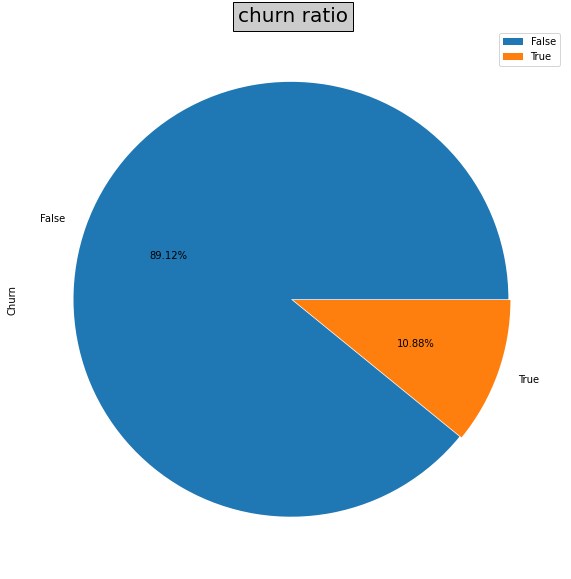

In [21]:
#ratio of users who churn
make_pieplot(telecom["Churn"],"Churn","churn ratio")

####Analysis on Categorical features

#####Dependency of churn on state:
Now here is statewise distribution of churn data.
Here we will look at which state has the max possibility that a account is churn.

In [22]:
state_churn=pd.crosstab(telecom["State"],telecom["Churn"])


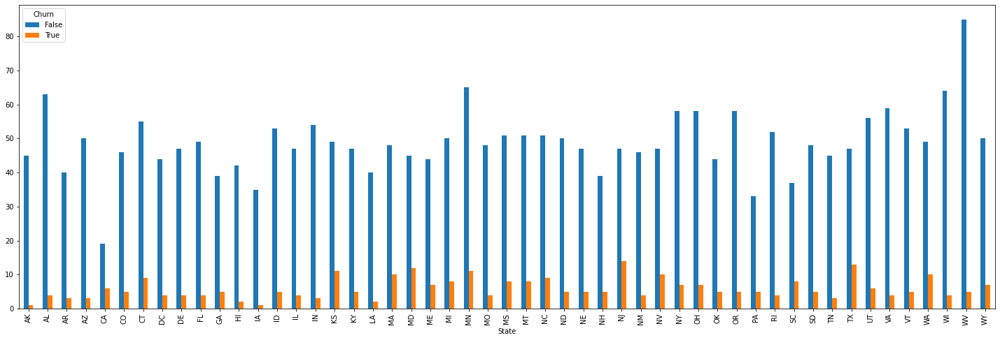

In [23]:
state_churn.plot(kind = 'bar', figsize=(25,8))

**Inference:** this plot shows which state have more number of churn customers and in which state we have more customers that are not churn, but we must want to know what percentage of customers in each state are churn and what is the probalility that if a customer belongs than he/she is a churn

In [24]:
# to judge what percentage of customers in a particulate are churn
state_churn_percentage=state_churn.copy()
total = state_churn[0]+state_churn[1]
state_churn_percentage[0] = round((state_churn[0]/total)*100,2)
state_churn_percentage[1] = round((state_churn[1]/total)*100,2)
state_churn_percentage.sort_values(by=True,inplace=True)


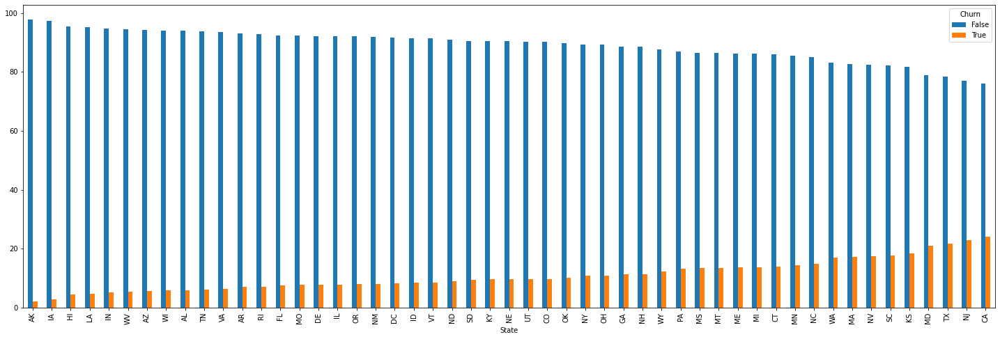

In [25]:

state_churn_percentage.plot(kind = 'bar', figsize=(25,8))

In [26]:
state_churn_percentage["state_number"]=[i for i in range(0, len(telecom["State"].unique()))]
state_positions=state_churn_percentage[["state_number"]]
telecom=telecom.merge(state_positions,on="State")

In [27]:
#states in which the chances of a customer to churn is more that 20% are:

(state_churn_percentage[True])[(state_churn_percentage[True]>=20 ).values]

#so in these 4 states the probability for a customer to be churn is comparitively higher 

State
MD    21.05
TX    21.67
NJ    22.95
CA    24.00
Name: True, dtype: float64

**Inference:** As some states have higher chances for an account to be churn so state can be important feaure to use as an independent feature in our model to decide whether an account will churn or not, so we decided a number for each state and numbers assigned to a state is decided such that a state with lower number have lesser chances for a customer to be churn. 

#####Account length column analysis

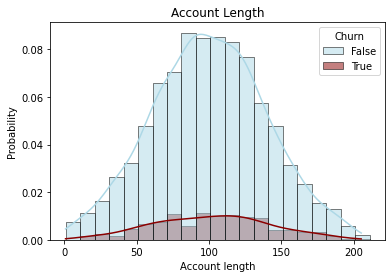

In [28]:
#what are the chances of a customer to be churn if he/she is a part of telecom from long time:
sns.histplot(data=telecom,x="Account length",stat="probability",binwidth=10,kde=True,linewidth=0.5,hue="Churn",palette=['lightblue','darkred'])
plt.title("Account length".title())
plt.show()

**Inference:** From above we note that there is a very low probability that a customer churn is beggining but between 50-150 days there is comparitively probability that a customer will churn but if account is more than 150 days that the probability reduces comparitively.

Here we also note that account length follows a normal distribution

In [29]:
minimum,maximum,mean_val,std_val=telecom["Account length"].agg(['min',max,'mean','std'])
print("\nminimum= ",minimum,"\nmaximum= ",maximum,"\nmean= ",mean_val,"\nstandard deviation= ",std_val)


minimum=  1.0 
maximum=  205.0 
mean=  100.37450769781597 
standard deviation=  39.34488724347849


In [30]:
from scipy.stats import norm
# norm(1,205)
z1_left= (mean_val)- (std_val)
z1_right= (mean_val)+( std_val)
z1_left,z1_right

(61.02962045433748, 139.71939494129447)

In [31]:
#lets make a separate copy for the data where account length is between 61-140, 
#so to analyze that case separately as most of the churn accounts lies in this range
bool_arr=((telecom["Account length"]>=z1_left) & (telecom["Account length"]<=z1_right)).values
telecom_account_length=telecom.loc[bool_arr].copy()
telecom_account_length.shape

(1885, 17)

#####Vmail Messages

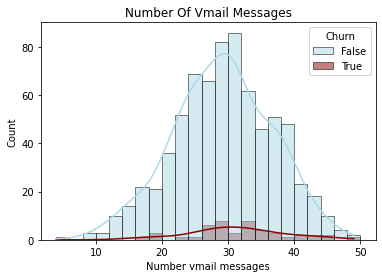

In [32]:
data=telecom[telecom["Number vmail messages"]>0]
sns.histplot(data=data,x="Number vmail messages",stat="count",binwidth=2,kde=True,linewidth=0.5,hue="Churn",palette=['lightblue','darkred'])
plt.title("Number of vmail messages".title())
plt.show()

**Inference: ** Distribution of non zero number of vmail messages also follows a normal distribution, and the value of number closer to the mean higher are the chances for a account to be churn, if the number of vmail messages are low then there is a very less chance to churn

In [33]:
#data with zero vmail messages
zero_data=telecom[telecom["Number vmail messages"]==0]
print("the churn division when we have 0 vmail messages: \n",zero_data["Churn"].value_counts())
print("\n\nthe churn division when we have non 0 vmail messages: \n ", data["Churn"].value_counts())

#so we note that most of the accounts that are churn have zero vmail messages.

the churn division when we have 0 vmail messages: 
 False    1760
True      258
Name: Churn, dtype: int64


the churn division when we have non 0 vmail messages: 
  False    729
True      46
Name: Churn, dtype: int64


In [34]:
def plot_bar(df,f1,distribution,per_not_churns):
  uq=len(df[f1].unique())
  distribution_graph = distribution.plot(kind = 'bar', figsize =(10,6))
  plt.title(f'{f1} v/s churn',bbox={'facecolor':'0.8', 'pad':5}, fontsize = 10,loc="right")
  i = 0
  for p in distribution_graph.patches[0:uq]:
    width = p.get_width()
    height = p.get_height()
    x, y = p.get_xy()
    plt.text(x+width/2, y+height*1.03,str(per_not_churns.values[i])+'%',ha='center',weight='bold')
    i+=1
  plt.show()


def plot_bar_compare(df,f1,f2):
  import pandas as pd
  distribution=pd.crosstab(df[f1],df[f2])
  distribution_percentage=distribution.copy()
  total = distribution[0]+distribution[1]
  distribution_percentage[0] = round((distribution[0]/total)*100,2)
  distribution_percentage[1] = round((distribution[1]/total)*100,2)
  per_not_churns=distribution_percentage[False]
  #print(per_not_churns)

  plot_bar(df,f1,distribution,per_not_churns)


#####Now let's have a look at some other categorical features:
- Area code: There is no as such impact of area on churning as percentage of churn is almost equal, but here I note that area with code 415 have very high number of telecom user's as compared to those in other two areas.

- International plan: It is a important feature, we note that moe than 40% of the users having international plan churns, so we must improve our international plan.

- Voice mail plan: We note that the people having voice mail plan have less probability to churn as compared to those who do not have a voice mail plan, so telecom must make it's voice mail plan accessible and useful for most of the users, and this will decrease the churn probability.

- Customer service calls: The number of customer service calls doesn't affect the churn probability much, also we note that most of the customers prefer one call.
- Total international calls: Most of the people do nearly 3-4 international calls, also the percentage of churn is very less here.

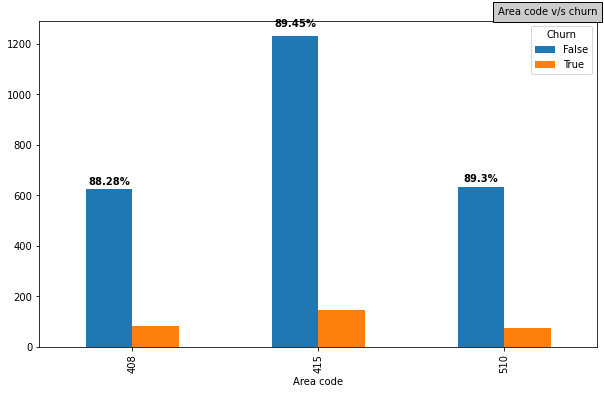

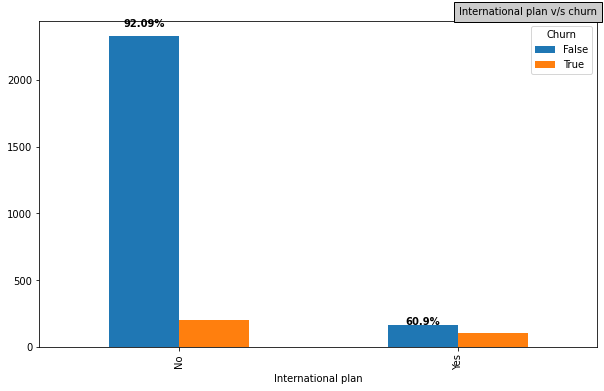

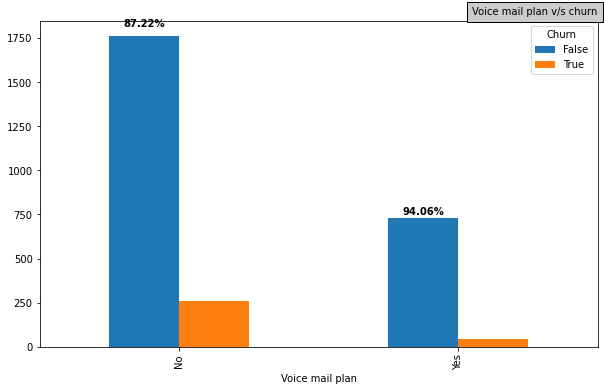

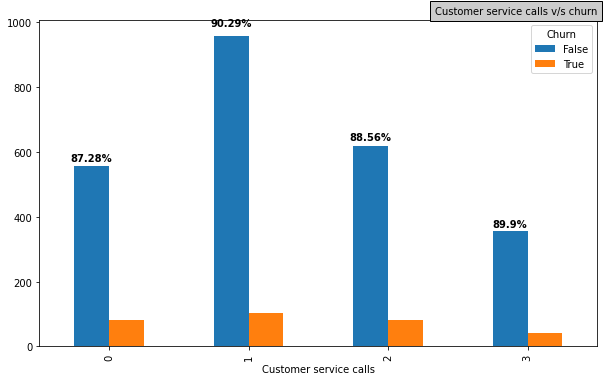

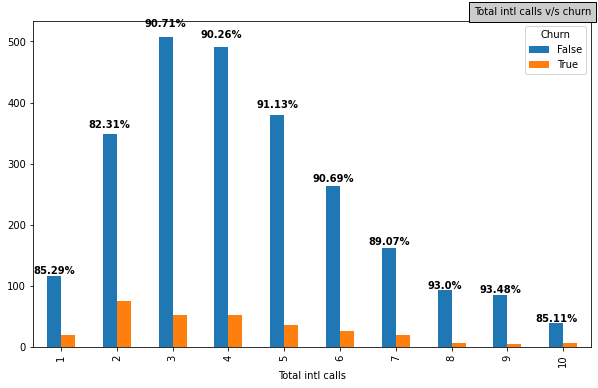

In [35]:
categorical_attributes=['Area code', 'International plan','Voice mail plan','Customer service calls',"Total intl calls"]
for i in categorical_attributes:
  plot_bar_compare(telecom,i,"Churn")



####Analysis On Continuous Features

#####Cost per min
All the four categories under this nearly follows a normal distribution.

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fd80ba32410>,
      dtype=object)

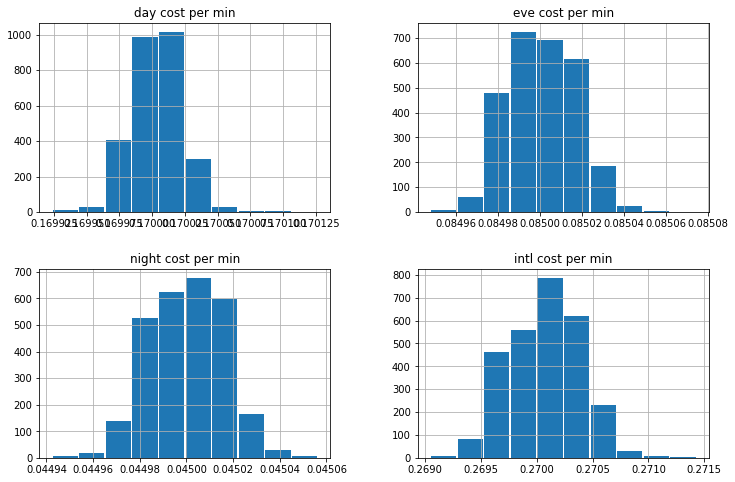

In [36]:
features = ['day cost per min','eve cost per min', 'night cost per min', 'intl cost per min' ]
telecom[features].hist(figsize=(12,8), rwidth=0.95)
#cost per min of calls nearly follows a normal distributuion

#####Bivariate Analysis
Here we observe relation of four continuous columns with each other and note that, no attribute shows a linear relation with any attribute, also all the attributes follows a normal distribution, but total international calls is right skewed, that is most of the people do less intl calls.

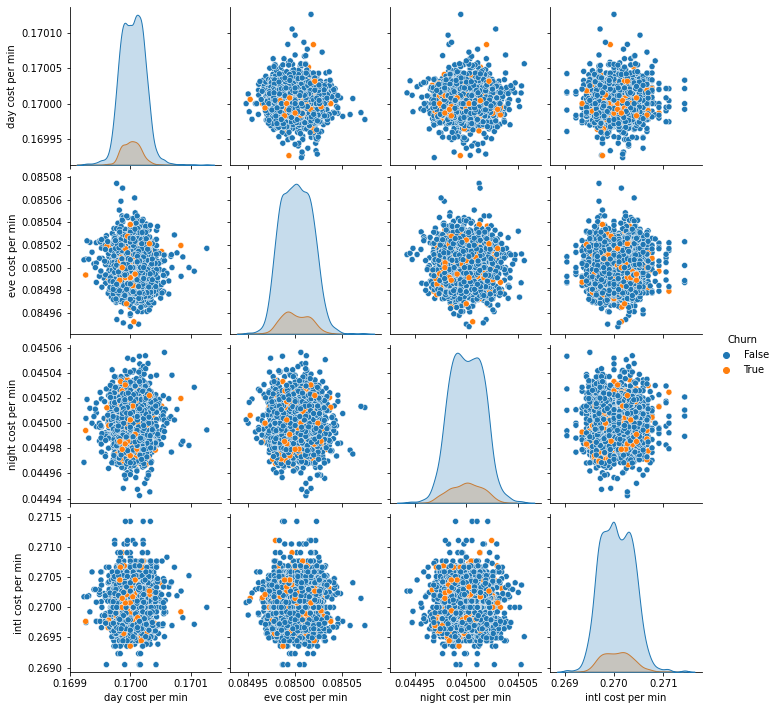

In [37]:
features = ['day cost per min','eve cost per min', 'night cost per min', 'intl cost per min' ,'Churn']
sns.pairplot(telecom[features],hue='Churn')

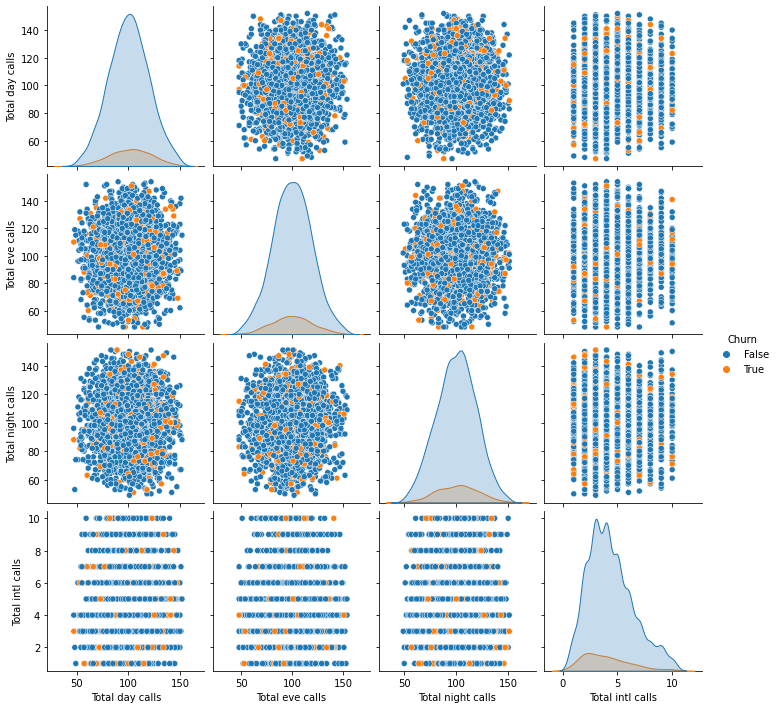

In [38]:
#now checking dependency of churn on call rate
features = ['Total day calls','Total eve calls', 'Total night calls', 'Total intl calls' ,'Churn']
sns.pairplot(telecom[features],hue='Churn')

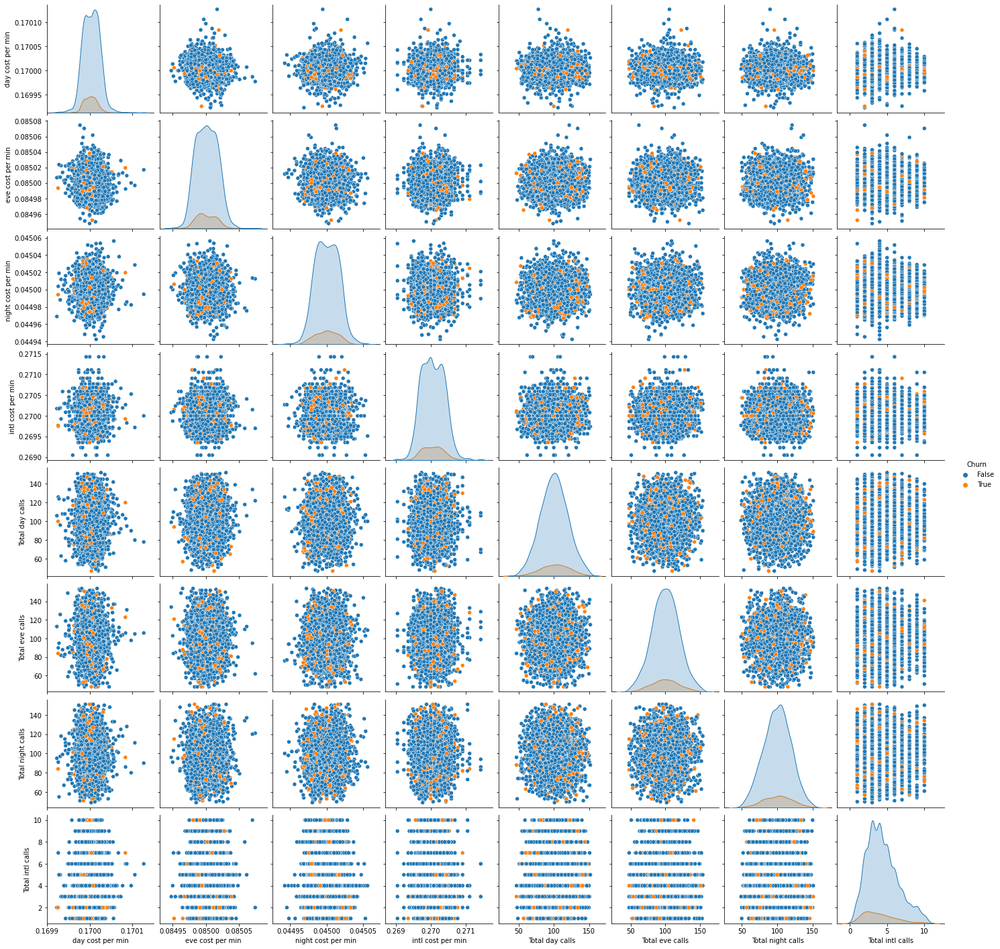

In [39]:
features = ['day cost per min','eve cost per min', 'night cost per min', 'intl cost per min' ,'Total day calls',
       'Total eve calls', 'Total night calls', 'Total intl calls','Churn']
sns.pairplot(telecom[features],hue='Churn')

**Inference:** From above we note that, we can not particularily separate churn data with non churn data, there is a possibility that at the same time a account having some set of attribute values is not churn, and another account with that same set of attributes as churn, mainly the cost of  day calls, vmail plan, international plan, voice mails all these attributes affects the conclusion whether a account is churn or not, but we dont find any such attribute which have high correlation with churn.

##Supervised machine learning: Classification model

Now I tried certain models to predict whether an account will churn or not, but because the data is highly biased and churn attribute do not have a good correlation with any other attribute, so the best model i get have 60% accuracy only and that is gradient boosting.

###Requirements for building a model.
- First of all we added some required attributes and make changes in some existing attributes. And then we decided independent and dependent variables.

- Also we have created a function which tests the model on three scales that are: Accuracy, auc-roc scores, confusion matrix.

In [40]:
#no: 0, yes: 1
telecom["class"]=[1 if i else 0 for i in telecom["Churn"]]
telecom["International plan"]=[1 if i=='Yes' else 0 for i in telecom["International plan"]]
telecom['Voice mail plan']=[1 if i=='Yes' else 0 for i in telecom["Voice mail plan"]]

corr_class=abs((telecom.corr())["class"]).sort_values(ascending=False)
independent_var=(corr_class.index)[2:]
dependent_var=["class"]

In [41]:
def model_checking(original,predicted,labels=["possibility1","possibility2"]):
  from sklearn.metrics import accuracy_score, confusion_matrix, roc_auc_score
  model_accuracy=accuracy_score(predicted,original)
  print("The accuracy of model is= ", model_accuracy,"\n")
  rocauc_score=roc_auc_score(original,predicted)
  print("The roc_auc score of model is= ", rocauc_score,"\n")
  print("Confusion matrix: \n")
  cm=confusion_matrix(original,predicted)
  print(cm)
  ax= plt.subplot()
  sns.heatmap(cm, annot=True, ax = ax) #annot=True to annotate cells
  # labels, title and ticks
  ax.set_xlabel('Predicted labels')
  ax.set_ylabel('True labels')
  ax.set_title('Confusion Matrix')
  ax.xaxis.set_ticklabels(labels)
  ax.yaxis.set_ticklabels(labels)

###Logistic Regression
- The accuracy of model is=  0.8912264995523724 
- The roc_auc score of model is=  0.5 



In [42]:
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, roc_auc_score

In [43]:
#in churn false: 0, true: 1
x=telecom[independent_var].copy()  #independent features
y=telecom["class"].copy()       #dependent features

In [44]:
#train test split
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2, random_state=0,stratify=y)

In [45]:
#fitting logistic regression on trained data
from sklearn.linear_model import LogisticRegression
model=LogisticRegression(fit_intercept=True, max_iter=10000)
model.fit(x_train,y_train)


LogisticRegression(max_iter=10000)

In [46]:
train_predict=model.predict_proba(x_train)[:,1]
test_predict=model.predict_proba(x_test)[:,1]

In [47]:
train_class_predict=model.predict(x_train)
test_class_predict=model.predict(x_test)

The accuracy of model is=  0.8997314234556849 

The roc_auc score of model is=  0.5734178287892223 

Confusion matrix: 

[[1972   19]
 [ 205   38]]


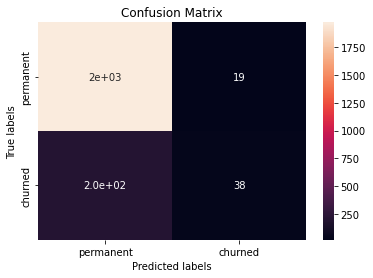

In [48]:
model_checking(y_train, train_class_predict,labels=["permanent","churned"])

Nearly 12%  of the total values are churn, now from confusion matrix we note that our model don't identity these value and shows 89% accuracy, 
in this case the model shows more accuracy but model is not at all good and will not be able to make correct predictions,
so we have to reject this model as this model is not working for a biased data.

###Decesion Tree
- The accuracy of model is=  0.9012787723785166 

- The roc_auc score of model is=  0.5530427070541684 

As the y attribute do not have any linear relation also logistic regression is not working so we will use decesion tree now to predict whether a customer is churn or not.

In [49]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier

In [50]:
x=telecom[independent_var]
y=telecom["class"]

In [51]:
x_train,x_test,y_train,y_test= train_test_split(x, y, test_size=0.30, random_state=324,stratify=y)

In [52]:
#fitting on train data
model2=DecisionTreeClassifier(criterion="entropy",max_leaf_nodes=20,max_depth=10,random_state=0)
model2.fit(x_train,y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=10, max_leaf_nodes=20,
                       random_state=0)

In [53]:
y_test_predicted=model2.predict(x_test)
y_train_predicted=model2.predict(x_train)

Acurracy of the model

The accuracy of model is=  0.9115089514066497 

The roc_auc score of model is=  0.6412857165957859 

Confusion matrix: 

[[1719   23]
 [ 150   63]]


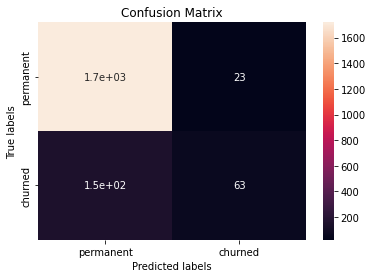

In [54]:
model_checking(y_train, y_train_predicted,labels=["permanent","churned"])

**Conclusion:** Here also the accuracy is not good, but it is better than before, let's try to do stratified sampling and use some other models

###Startified Sampling
- The accuracy of model is=  0.8969210174029452 

- The roc_auc score of model is=  0.5900472001972309 

In [55]:
#stratified sampling
churn_data=telecom.loc[telecom["class"]==1]
not_churn_data=telecom.loc[telecom["class"]==0]
churn_data.shape

(304, 18)

In [56]:
#help(telecom.sample)
churn_data=churn_data.sample(ignore_index=True,frac=1,random_state=1,replace=True)
not_churn_data=not_churn_data.sample(ignore_index=True,frac=1,random_state=1,replace=True)

In [57]:
churn_data.shape,not_churn_data.shape,telecom.shape

((304, 18), (2489, 18), (2793, 18))

In [58]:
(2489*80)/100

1991.2

In [59]:
training=(churn_data.iloc[:250].append(not_churn_data.iloc[:1991],ignore_index=True)).sample(ignore_index=True,frac=1,random_state=1,replace=True)
testing=(churn_data.iloc[250:].append(not_churn_data.iloc[1991:],ignore_index=True)).sample(ignore_index=True,frac=1,random_state=1,replace=True)

In [60]:
#uptill  now we do not get satisfactory results
#as the data is highly biased so lets try doing startified sampling
x_train=training[independent_var]
x_test=testing[independent_var]
y_train=training[dependent_var]
y_test=testing[dependent_var]

In [61]:
#fitting on train data
model3=DecisionTreeClassifier(criterion="entropy",max_leaf_nodes=20,max_depth=10,random_state=0)
model3.fit(x_train,y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=10, max_leaf_nodes=20,
                       random_state=0)

In [62]:
y_test_predicted=model3.predict(x_test)
y_train_predicted=model3.predict(x_train)

In [63]:
pd.Series(y_test_predicted).value_counts()

0    521
1     31
dtype: int64

The accuracy of model is=  0.92681838464971 

The roc_auc score of model is=  0.7224582673909068 

Confusion matrix: 

[[1961   27]
 [ 137  116]]


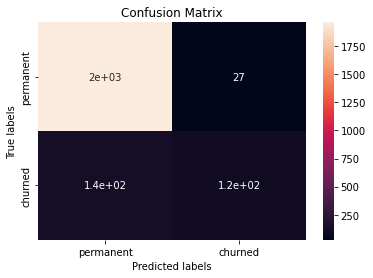

In [64]:
model_checking(y_train, y_train_predicted,labels=["permanent","churned"])

In [65]:
#after doing stratified sampling results gets improved but, not satisfactory, so now let's try random forest and gradient boosting.
"""
also we note from our analysis that the chances of a customer to be churn is not  very certain, for same conditions customer can be both churn and 
not churn, so the above mmodel guess the person to be churn when there is a high probability, so above model is quite acceptable
but let's try to make a better one
"""

"\nalso we note from our analysis that the chances of a customer to be churn is not  very certain, for same conditions customer can be both churn and \nnot churn, so the above mmodel guess the person to be churn when there is a high probability, so above model is quite acceptable\nbut let's try to make a better one\n"

###Grey Box Models

We are not able to get a good model using any white box model so let's try some grey box models.

In [ ]:
x=telecom[independent_var]
y=telecom["class"]
x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state = 0, stratify = y)

####Random Forest  Classifier
- The accuracy of model is=  0.8925693822739481 

- The roc_auc score of model is=  0.5061728395061729 

In [66]:
#random forest classifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

In [68]:
model4=RandomForestClassifier()
grid_values = {'n_estimators':[50, 80,  100], 'max_depth':[3, 5, 7]}
model4 = GridSearchCV(model4, param_grid = grid_values, scoring = 'roc_auc', cv=5)

model4.fit(x_train,y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'max_depth': [3, 5, 7], 'n_estimators': [50, 80, 100]},
             scoring='roc_auc')

In [69]:
y_train_predicted=model4.predict(x_train)
y_test_predicted=model4.predict(x_test)

The accuracy of model is=  0.9086839749328559 

The roc_auc score of model is=  0.5802469135802469 

Confusion matrix: 

[[1991    0]
 [ 204   39]]


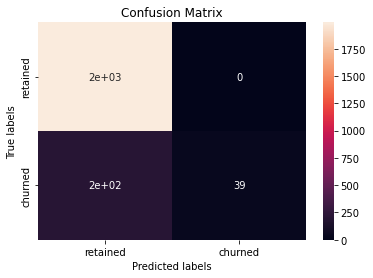

In [70]:
model_checking(y_train,y_train_predicted,["retained","churned"])

**Conclusion:** Here also the model is not good, stratified sampling model that is model 3 was better than this so we reject this model

####Gradient Boosting
- For train data:
  - The accuracy of model is=  0.9758281110116384  

  - The roc_auc score of model is=  0.8888888888888888

- For test data:
  - The accuracy of model is=  0.8908765652951699 

  - The roc_auc score of model is= 0.593505168213839

  Finally we get a better results so we choose gradient boosting as our final model, also we note that none of the feature have very good relation with churn so according to the uncertainity of data given to us, this result is quite good

#####Model Building

finally we used this model as we are getting maximum aucroc scores.

In [97]:
#gradient boosting
from sklearn.ensemble import GradientBoostingClassifier
model5=GradientBoostingClassifier()
grid_values = {'n_estimators':[50, 80, 100], 'max_depth':[6, 6, 8]}
model5 = GridSearchCV(model5, param_grid = grid_values, scoring = 'roc_auc', cv=5)

model5.fit(x_train,y_train)


GridSearchCV(cv=5, estimator=GradientBoostingClassifier(),
             param_grid={'max_depth': [6, 6, 8], 'n_estimators': [50, 80, 100]},
             scoring='roc_auc')

#####Predicting Probabilities And Result

From our observation we conclude that, in this data the account is churn or not is not very certain so we also finded that for a given set of attributes for a account what is the probability that the data is churn.

So the some accounts that are churn but not predicted as churn must have low probability to churn,

In [98]:
def predict_value(val1,val2,probability,p1=0.5):
  """
  this function will check whether the value will be val1 or val2, depending on the probability.
  In this we can decide our own threshold probability, by default p1 is 0.5
  """
  predicted=[]
  for i in probability:
    if i[0] <=p1:
      predicted.append(val2)
    else:
      predicted.append(val1)
  
  return predicted

  

In [99]:
y_train_predicted_proba=model5.predict_proba(x_train)
y_train_predicted=predict_value(0,1,y_train_predicted_proba,0.65)

y_test_predicted_proba=model5.predict_proba(x_test)
y_test_predicted=predict_value(0,1,y_test_predicted_proba,0.65)

#####Model Testing

The accuracy of model is=  0.9758281110116384 

The roc_auc score of model is=  0.8888888888888888 

Confusion matrix: 

[[1991    0]
 [  54  189]]


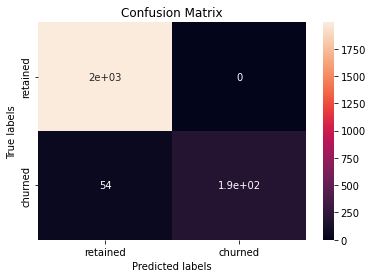

The accuracy of model is=  0.9758281110116384 

The roc_auc score of model is=  0.8888888888888888 

Confusion matrix: 

[[1991    0]
 [  54  189]]


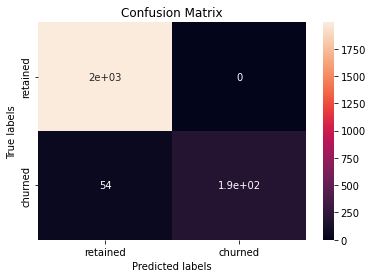

In [114]:
#for train data
model_checking(y_train,y_train_predicted,["retained","churned"])

The accuracy of model is=  0.8908765652951699 

The roc_auc score of model is=  0.593505168213839 

Confusion matrix: 

[[485  13]
 [ 48  13]]


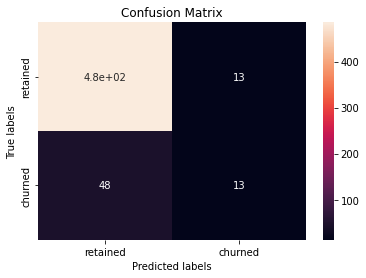

The accuracy of model is=  0.8908765652951699 

The roc_auc score of model is=  0.593505168213839 

Confusion matrix: 

[[485  13]
 [ 48  13]]


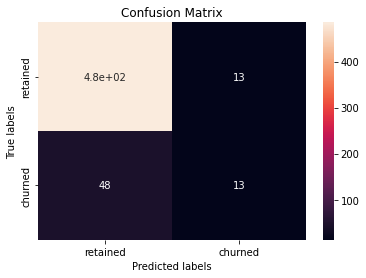

In [115]:
#For test data
model_checking(y_test,y_test_predicted,["retained","churned"])

#####Model Explaination
Now let's understand the results of model using lime

In [102]:
#model explaination using lime, to judge which feature is resulting in churn of data.
!pip install lime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [103]:
import sklearn
import sklearn.datasets
import sklearn.ensemble
import lime
import lime.lime_tabular
from __future__ import print_function
prediction_func=lambda x: model5.predict_proba(x).astype(float)


In [120]:
feature_names=independent_var
feature_names

Index(['International plan', 'state_number', 'Voice mail plan',
       'Number vmail messages', 'Total intl calls', 'day cost per min',
       'Total day calls', 'Total night calls', 'Customer service calls',
       'eve cost per min', 'Account length', 'night cost per min',
       'intl cost per min', 'Area code', 'Total eve calls'],
      dtype='object')

In [121]:
x_train_array=np.array(x_train)
x_test_array=np.array(x_test)

In [122]:
#creating the lime explainer
explainer=lime.lime_tabular.LimeTabularExplainer(x_train_array,feature_names=feature_names)

In [125]:
#finding first five indexess which are predicted as churn 
predicted_churn_index=list(np.where((np.array(y_test_predicted))==1))
predicted_churn_index=predicted_churn_index[0]
predicted_five_churn_index=predicted_churn_index[0:5]

In [126]:

for i in predicted_five_churn_index:
  exp=explainer.explain_instance(x_test_array[i],prediction_func, num_features=6)
  exp.show_in_notebook(show_all=False)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  "X does not have valid feature names, but"


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  "X does not have valid feature names, but"


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  "X does not have valid feature names, but"


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  "X does not have valid feature names, but"


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  "X does not have valid feature names, but"


Conlusion:
- Day call cost per min and international call cost per min must be reduced, as from above we conclude that more the day and international call cost is more are the chances for a customer to churn.
- Also the customer having international plan churn's more frequenty as compared to those who do not have an interational plan.

In [127]:
#finding first five indexess which are predicted as not churn 
predicted_not_churn_index=list(np.where((np.array(y_test_predicted))==0))
predicted_not_churn_index=predicted_not_churn_index[0]
predicted_five_not_churn_index=predicted_not_churn_index[0:5]

In [128]:
for i in predicted_five_not_churn_index:
  exp=explainer.explain_instance(x_test_array[i],prediction_func, num_features=6)
  exp.show_in_notebook(show_all=False)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  "X does not have valid feature names, but"


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  "X does not have valid feature names, but"


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  "X does not have valid feature names, but"


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  "X does not have valid feature names, but"


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  "X does not have valid feature names, but"
